## Clustering using TF-IDF Vectorization with MiniBatchKMeans

In this notebook, we will use TF-IDF Vectorization and MiniBatchKMeans clustering technique.

To judge the clustering technique, We will use `Silhouette Coefficient` as we are not having labels to judge the clustering model.

We will also use LSA ([Latent Semantic Analysis](https://en.wikipedia.org/wiki/Latent_semantic_analysis)) for dimensionality reduction.

#### Import necessary libraries

In [17]:
from pathlib import Path
from time import time
from collections import defaultdict

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.cluster import MiniBatchKMeans
from sklearn import metrics
from sklearn.decomposition import PCA 
import seaborn as sns
import matplotlib.pyplot as plt

# fit_and_evaluate take the MiniBatchKMeans model and dataset
# And showcase the metrices value (like Silhouette score)
from utils import fit_and_evaluate

### Loading preprocessed_dataset

In [207]:
dataset_path = Path("../dataset/preprocessed_data.csv")
dataset = pd.read_csv(dataset_path, encoding="utf-8")
dataset.head()

,Text
0,moeller student-run newspaper crusader consist...
1,crusader first place second-highest honor high...
2,squire student literary journal features stori...
3,paul keels - play-by-play announcer ohio state...
4,joe uecker - ohio state senator


### Feature Extraction using TfidfVectorizer

In [10]:
# fill NaN values
dataset = dataset.fillna("None")

In [11]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(
    # if the word is present in more than 80% of documents, will not be considered
    max_df=0.8,
    # minimum number of docs which consists particular word
    min_df=5,
    stop_words="english",
    ngram_range=(1,3),
    use_idf=True,
)

t0 = time()
X_tfidf = vectorizer.fit_transform(dataset["Text"])

print(f"vectorization done in {time() - t0:.5f} s")
print(f"n_samples: {X_tfidf.shape[0]}, n_features: {X_tfidf.shape[1]}")

vectorization done in 7.45622 s
n_samples: 46117, n_features: 18960


There are approx `19K` features. which is huge

Let's see the Sparsity

#### save the vectorizer

In [204]:
import joblib
joblib.dump(vectorizer, "../model/tfidf_vectorizer.pickle")

['../model/tfidf_vectorizer.pickle']

#### Sparsity

In [12]:
print(f"The sparsity is: {X_tfidf.nnz/np.prod(X_tfidf.shape):.3f}")

The sparsity is: 0.001


We find that around `0.1%` of the entries of the `X_tfidf` matrix are non-zero.

### Reducing the no.of dimension using LSA

ref: [See LSA in detail!](https://en.wikipedia.org/wiki/Latent_semantic_analysis)

In [205]:
from sklearn.decomposition import TruncatedSVD
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import Normalizer

# As TruncatedSVD result is not Normalized, we'll Normalize the result also
lsa = make_pipeline(TruncatedSVD(n_components=100), Normalizer(copy=False))
t0 = time()
X_lsa = lsa.fit_transform(X_tfidf)
explained_variance = lsa[0].explained_variance_ratio_.sum()
print(f"LSA done in {time() - t0:.3f} s")
print(f"Explained variance of the SVD step: {explained_variance * 100:.1f}%")

LSA done in 2.229 s
Explained variance of the SVD step: 7.6%


In [206]:
# save lsa pipeline
import joblib
joblib.dump(lsa, "../model/lsa.pickle")

['../model/lsa.pickle']

### Visualize the data in 3D

In [14]:
# !pip install cufflinks plotly

In [186]:
# to visualize high-dimensional data into lower-dimension(2D)
import plotly.express as px
def visualize_data_3d(X, labels=None, path=None)->None:
    """
    this method takes high-dimensional data and change it into lower-dimension
    using PCA. (3D)
    """
    pca = PCA(n_components=3, svd_solver="auto")
    components = pca.fit_transform(X)
    total_var = pca.explained_variance_ratio_.sum()*100
    
    X_pca = pd.DataFrame({"0":components[:,0], "1":components[:,1], "2": components[:,2]})
    
    fig = px.scatter_3d(
        components, x=0, y=1, z=2, color=labels,
        title=f"Total Explained Variance: {total_var:.2f}%",
        labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'},
    )
    if path is not None:
        fig.write_html(path)
    fig.show()

In [187]:
visualize_data_3d(X_lsa)

### Clustering with MiniBatchKMeans

#### finding K(n_clusters) value using Elbow method

Just Visualizing the data with reduced no.of features can't always give the best result.
So, we will find the value of `K` by using Elbow method.

There are two things to understand
1. __Distortion__: it is calculated as the average of the squared distance from the cluster centers of the respective clusters. Typically, the __Euclidean distance__ metric is used.
2. __Inertia__: it is the sum of squared distances of samples of their closest cluster center.

##### Building the clustering model and calculating the values of the `Distortion` and `Inertia`:

In [21]:
from sklearn import metrics
from scipy.spatial.distance import cdist
from typing import List
  
def getting_distortion_and_inertia(X, K:List[int]):
    distortions = []
    inertias = []
    mapping1 = {}
    mapping2 = {}
    count=1
    for k in K:
        t0 = time()
        # Building and fitting the model
        kmeans_model = MiniBatchKMeans(n_clusters=k).fit(X)
        kmeans_model.fit(X)
    
        distortions.append(sum(np.min(cdist(X, kmeans_model.cluster_centers_,
                                            'euclidean'), axis=1)) / X.shape[0])
        inertias.append(kmeans_model.inertia_)
    
        mapping1[k] = sum(np.min(cdist(X, kmeans_model.cluster_centers_,
                                    'euclidean'), axis=1)) / X.shape[0]
        mapping2[k] = kmeans_model.inertia_

        print(f"Time taken in iteration {count} = {time()-t0}")
        count+=1

    return (
        distortions,
        inertias,
        mapping1,
        mapping2,
    )
    

In [22]:
list_of_cluster_size = range(1,300)
distortions, inertias, mapping1, mapping2 = getting_distortion_and_inertia(X_lsa, list_of_cluster_size)

Time taken in iteration 1 = 0.9307670593261719
Time taken in iteration 2 = 0.6305239200592041
Time taken in iteration 3 = 0.7311990261077881
Time taken in iteration 4 = 0.7159152030944824
Time taken in iteration 5 = 0.6847329139709473
Time taken in iteration 6 = 0.7394897937774658
Time taken in iteration 7 = 0.7043197154998779
Time taken in iteration 8 = 0.7214133739471436
Time taken in iteration 9 = 0.8377714157104492
Time taken in iteration 10 = 0.7919666767120361
Time taken in iteration 11 = 0.9301228523254395
Time taken in iteration 12 = 0.8117153644561768
Time taken in iteration 13 = 1.0044479370117188
Time taken in iteration 14 = 1.0167231559753418
Time taken in iteration 15 = 0.9892826080322266
Time taken in iteration 16 = 0.9135286808013916
Time taken in iteration 17 = 1.0776066780090332
Time taken in iteration 18 = 1.1608591079711914
Time taken in iteration 19 = 1.1262304782867432
Time taken in iteration 20 = 1.1332707405090332
Time taken in iteration 21 = 1.347381353378296
Ti

Time taken in iteration 173 = 6.483311176300049
Time taken in iteration 174 = 6.476421117782593
Time taken in iteration 175 = 6.3241307735443115
Time taken in iteration 176 = 5.960215091705322
Time taken in iteration 177 = 6.292363166809082
Time taken in iteration 178 = 6.346085071563721
Time taken in iteration 179 = 5.911084413528442
Time taken in iteration 180 = 6.602245092391968
Time taken in iteration 181 = 6.602567195892334
Time taken in iteration 182 = 6.398620367050171
Time taken in iteration 183 = 6.558614492416382
Time taken in iteration 184 = 6.407322645187378
Time taken in iteration 185 = 6.283174514770508
Time taken in iteration 186 = 6.35064172744751
Time taken in iteration 187 = 6.511967658996582
Time taken in iteration 188 = 6.571758508682251
Time taken in iteration 189 = 6.644149303436279
Time taken in iteration 190 = 6.939997911453247
Time taken in iteration 191 = 6.970307111740112
Time taken in iteration 192 = 6.53117823600769
Time taken in iteration 193 = 6.426266193

#### Tabulating and Visualizing the results

##### Using the different values of distortions

In [28]:
# for key, value in mapping1.items():
#     print(f"{key}: {value}")

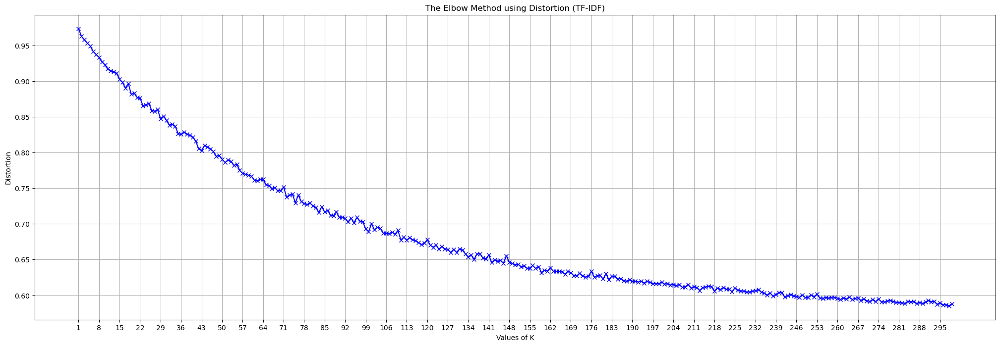

In [180]:
# plotting distortions
plt.figure(figsize=(25,8))
plt.plot(list_of_cluster_size, distortions, 'bx-')
plt.xlabel('Values of K')
plt.xticks(list_of_cluster_size[::7])
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion (TF-IDF)')
plt.grid()
plt.show()

##### Using the different values of Inertia

In [30]:
# for key, value in mapping2.items():
#     print(f"{key}: {value}")

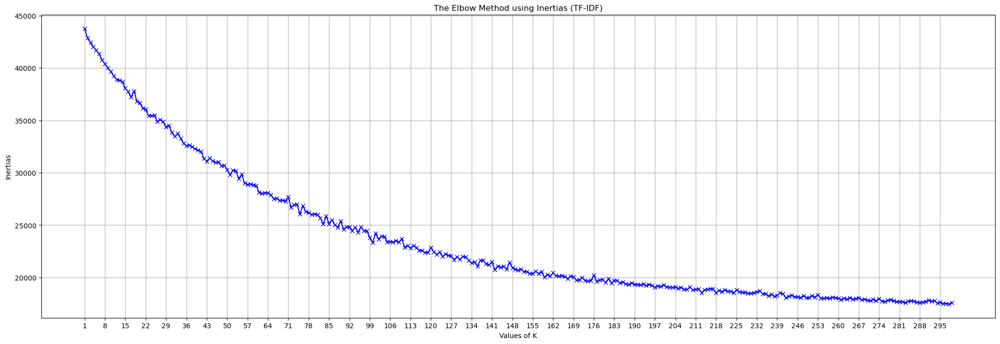

In [179]:
# plotting distortions 
plt.figure(figsize=(25,8))
plt.plot(list_of_cluster_size, inertias, 'bx-')
plt.xlabel('Values of K')
plt.xticks(list_of_cluster_size[::7])
plt.ylabel('Inertias')
plt.title('The Elbow Method using Inertias (TF-IDF)')
plt.grid()
plt.show()

__Summary__: 
- There is no abrupt changes in the Inertia or distortions. So, It is very hard to get the value of K using Elbow method

### Let's evaluate model on different `n_clusters` value using `Silhouette coefficient`

In [67]:
count=1
scores = {} # dict to store the results for each 
for i in range(2,300):
    print(f"------ iteration : {count} , n_clusters: {i}------")
    kmeans = MiniBatchKMeans(
        n_clusters=i,
        max_iter=100,
        n_init=10,
    )
    score_dict = fit_and_evaluate(kmeans,X_lsa)
    scores[i] = score_dict
    count+=1
    print()

------ iteration : 1 , n_clusters: 2------
Clustering done in 0.35 ± 0.06 s
Silhouette Coefficient: 0.017 ± 0.001
Calinski-Harabasz Index: 994.298 ± 21.674
Davies-Bouldin Index: 6.309 ± 0.190

------ iteration : 2 , n_clusters: 3------
Clustering done in 0.39 ± 0.07 s
Silhouette Coefficient: 0.013 ± 0.009
Calinski-Harabasz Index: 644.690 ± 205.879
Davies-Bouldin Index: 6.203 ± 1.821

------ iteration : 3 , n_clusters: 4------
Clustering done in 0.36 ± 0.05 s
Silhouette Coefficient: 0.017 ± 0.003
Calinski-Harabasz Index: 602.552 ± 96.073
Davies-Bouldin Index: 6.139 ± 1.688

------ iteration : 4 , n_clusters: 5------
Clustering done in 0.37 ± 0.05 s
Silhouette Coefficient: 0.022 ± 0.002
Calinski-Harabasz Index: 614.477 ± 35.688
Davies-Bouldin Index: 5.737 ± 1.052

------ iteration : 5 , n_clusters: 6------
Clustering done in 0.44 ± 0.05 s
Silhouette Coefficient: 0.021 ± 0.004
Calinski-Harabasz Index: 554.487 ± 27.016
Davies-Bouldin Index: 5.569 ± 0.656

------ iteration : 6 , n_clusters:

Clustering done in 1.14 ± 0.09 s
Silhouette Coefficient: 0.100 ± 0.004
Calinski-Harabasz Index: 431.252 ± 4.988
Davies-Bouldin Index: 2.797 ± 0.101

------ iteration : 44 , n_clusters: 45------
Clustering done in 1.02 ± 0.06 s
Silhouette Coefficient: 0.093 ± 0.005
Calinski-Harabasz Index: 418.148 ± 8.736
Davies-Bouldin Index: 2.724 ± 0.064

------ iteration : 45 , n_clusters: 46------
Clustering done in 1.10 ± 0.10 s
Silhouette Coefficient: 0.103 ± 0.004
Calinski-Harabasz Index: 424.793 ± 14.019
Davies-Bouldin Index: 2.774 ± 0.084

------ iteration : 46 , n_clusters: 47------
Clustering done in 1.23 ± 0.16 s
Silhouette Coefficient: 0.107 ± 0.004
Calinski-Harabasz Index: 431.435 ± 11.512
Davies-Bouldin Index: 2.689 ± 0.106

------ iteration : 47 , n_clusters: 48------
Clustering done in 1.57 ± 0.22 s
Silhouette Coefficient: 0.103 ± 0.004
Calinski-Harabasz Index: 423.914 ± 8.347
Davies-Bouldin Index: 2.715 ± 0.038

------ iteration : 48 , n_clusters: 49------
Clustering done in 1.15 ± 0.

Clustering done in 1.76 ± 0.12 s
Silhouette Coefficient: 0.138 ± 0.009
Calinski-Harabasz Index: 393.881 ± 3.189
Davies-Bouldin Index: 2.453 ± 0.033

------ iteration : 87 , n_clusters: 88------
Clustering done in 1.65 ± 0.04 s
Silhouette Coefficient: 0.131 ± 0.006
Calinski-Harabasz Index: 382.706 ± 9.750
Davies-Bouldin Index: 2.471 ± 0.063

------ iteration : 88 , n_clusters: 89------
Clustering done in 1.65 ± 0.06 s
Silhouette Coefficient: 0.139 ± 0.004
Calinski-Harabasz Index: 393.289 ± 7.095
Davies-Bouldin Index: 2.454 ± 0.056

------ iteration : 89 , n_clusters: 90------
Clustering done in 1.68 ± 0.06 s
Silhouette Coefficient: 0.140 ± 0.005
Calinski-Harabasz Index: 390.924 ± 6.167
Davies-Bouldin Index: 2.431 ± 0.025

------ iteration : 90 , n_clusters: 91------
Clustering done in 1.71 ± 0.10 s
Silhouette Coefficient: 0.145 ± 0.008
Calinski-Harabasz Index: 393.080 ± 6.561
Davies-Bouldin Index: 2.428 ± 0.046

------ iteration : 91 , n_clusters: 92------
Clustering done in 1.76 ± 0.09

Clustering done in 0.59 ± 0.02 s
Silhouette Coefficient: 0.160 ± 0.009
Calinski-Harabasz Index: 362.419 ± 7.081
Davies-Bouldin Index: 2.278 ± 0.066

------ iteration : 129 , n_clusters: 130------
Clustering done in 0.59 ± 0.02 s
Silhouette Coefficient: 0.158 ± 0.005
Calinski-Harabasz Index: 359.035 ± 2.593
Davies-Bouldin Index: 2.283 ± 0.027

------ iteration : 130 , n_clusters: 131------
Clustering done in 0.60 ± 0.02 s
Silhouette Coefficient: 0.155 ± 0.004
Calinski-Harabasz Index: 362.905 ± 3.544
Davies-Bouldin Index: 2.289 ± 0.070

------ iteration : 131 , n_clusters: 132------
Clustering done in 0.59 ± 0.01 s
Silhouette Coefficient: 0.156 ± 0.006
Calinski-Harabasz Index: 359.308 ± 5.558
Davies-Bouldin Index: 2.314 ± 0.040

------ iteration : 132 , n_clusters: 133------
Clustering done in 0.59 ± 0.02 s
Silhouette Coefficient: 0.160 ± 0.004
Calinski-Harabasz Index: 360.329 ± 2.259
Davies-Bouldin Index: 2.271 ± 0.036

------ iteration : 133 , n_clusters: 134------
Clustering done in 0

Clustering done in 0.77 ± 0.02 s
Silhouette Coefficient: 0.159 ± 0.007
Calinski-Harabasz Index: 325.274 ± 4.555
Davies-Bouldin Index: 2.221 ± 0.078

------ iteration : 171 , n_clusters: 172------
Clustering done in 0.77 ± 0.03 s
Silhouette Coefficient: 0.155 ± 0.011
Calinski-Harabasz Index: 324.535 ± 4.595
Davies-Bouldin Index: 2.257 ± 0.043

------ iteration : 172 , n_clusters: 173------
Clustering done in 0.76 ± 0.01 s
Silhouette Coefficient: 0.164 ± 0.003
Calinski-Harabasz Index: 327.135 ± 4.062
Davies-Bouldin Index: 2.198 ± 0.093

------ iteration : 173 , n_clusters: 174------
Clustering done in 0.80 ± 0.02 s
Silhouette Coefficient: 0.160 ± 0.005
Calinski-Harabasz Index: 324.448 ± 3.835
Davies-Bouldin Index: 2.248 ± 0.044

------ iteration : 174 , n_clusters: 175------
Clustering done in 0.84 ± 0.03 s
Silhouette Coefficient: 0.163 ± 0.003
Calinski-Harabasz Index: 324.152 ± 2.119
Davies-Bouldin Index: 2.223 ± 0.033

------ iteration : 175 , n_clusters: 176------
Clustering done in 0

Clustering done in 0.94 ± 0.04 s
Silhouette Coefficient: 0.151 ± 0.006
Calinski-Harabasz Index: 288.576 ± 3.523
Davies-Bouldin Index: 2.263 ± 0.071

------ iteration : 213 , n_clusters: 214------
Clustering done in 0.97 ± 0.02 s
Silhouette Coefficient: 0.160 ± 0.010
Calinski-Harabasz Index: 288.683 ± 4.459
Davies-Bouldin Index: 2.241 ± 0.056

------ iteration : 214 , n_clusters: 215------
Clustering done in 0.98 ± 0.03 s
Silhouette Coefficient: 0.152 ± 0.005
Calinski-Harabasz Index: 287.203 ± 2.657
Davies-Bouldin Index: 2.290 ± 0.028

------ iteration : 215 , n_clusters: 216------
Clustering done in 0.98 ± 0.03 s
Silhouette Coefficient: 0.157 ± 0.010
Calinski-Harabasz Index: 287.189 ± 2.177
Davies-Bouldin Index: 2.231 ± 0.052

------ iteration : 216 , n_clusters: 217------
Clustering done in 0.98 ± 0.02 s
Silhouette Coefficient: 0.151 ± 0.005
Calinski-Harabasz Index: 283.383 ± 3.418
Davies-Bouldin Index: 2.275 ± 0.041

------ iteration : 217 , n_clusters: 218------
Clustering done in 1

Clustering done in 1.22 ± 0.06 s
Silhouette Coefficient: 0.153 ± 0.005
Calinski-Harabasz Index: 258.189 ± 2.020
Davies-Bouldin Index: 2.304 ± 0.042

------ iteration : 255 , n_clusters: 256------
Clustering done in 1.16 ± 0.02 s
Silhouette Coefficient: 0.145 ± 0.005
Calinski-Harabasz Index: 257.902 ± 2.220
Davies-Bouldin Index: 2.276 ± 0.019

------ iteration : 256 , n_clusters: 257------
Clustering done in 1.18 ± 0.02 s
Silhouette Coefficient: 0.151 ± 0.009
Calinski-Harabasz Index: 258.512 ± 0.668
Davies-Bouldin Index: 2.257 ± 0.043

------ iteration : 257 , n_clusters: 258------
Clustering done in 1.24 ± 0.06 s
Silhouette Coefficient: 0.146 ± 0.003
Calinski-Harabasz Index: 255.004 ± 2.656
Davies-Bouldin Index: 2.328 ± 0.061

------ iteration : 258 , n_clusters: 259------
Clustering done in 1.17 ± 0.03 s
Silhouette Coefficient: 0.149 ± 0.004
Calinski-Harabasz Index: 254.422 ± 1.195
Davies-Bouldin Index: 2.286 ± 0.032

------ iteration : 259 , n_clusters: 260------
Clustering done in 1

Clustering done in 1.36 ± 0.05 s
Silhouette Coefficient: 0.130 ± 0.012
Calinski-Harabasz Index: 232.178 ± 0.483
Davies-Bouldin Index: 2.356 ± 0.041

------ iteration : 297 , n_clusters: 298------
Clustering done in 1.35 ± 0.01 s
Silhouette Coefficient: 0.138 ± 0.003
Calinski-Harabasz Index: 232.262 ± 1.722
Davies-Bouldin Index: 2.332 ± 0.034

------ iteration : 298 , n_clusters: 299------
Clustering done in 1.47 ± 0.19 s
Silhouette Coefficient: 0.139 ± 0.003
Calinski-Harabasz Index: 230.173 ± 1.220
Davies-Bouldin Index: 2.324 ± 0.027



In [71]:
metrics_result = {}
for item in scores.items():
    key, value = item
    for metric in value:
        if metric not in metrics_result:
            metrics_result[metric] = [np.array(value[metric]).mean()]
        else:
            metrics_result[metric].append(np.array(value[metric]).mean())

In [74]:
len(metrics_result["Silhouette Coefficient"])

298

In [89]:
list_of_cluster_size

range(1, 300)

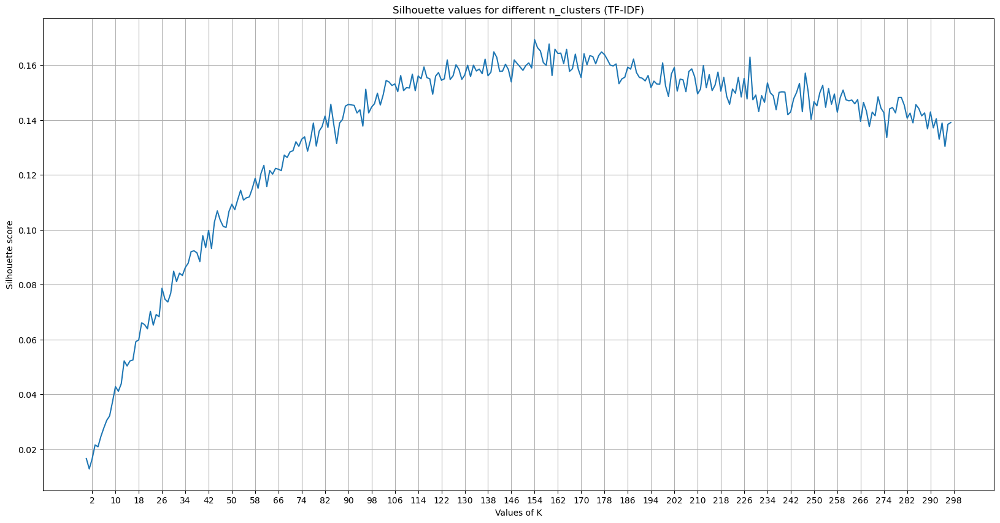

In [181]:
# plotting Silhouette scores
plt.figure(figsize=(20,10))
plt.plot(metrics_result['Silhouette Coefficient'])
plt.xlabel('Values of K')
plt.xticks(list_of_cluster_size[1::8])
plt.ylabel('Silhouette score')
plt.title('Silhouette values for different n_clusters (TF-IDF)')
plt.grid()
plt.show()

In [95]:
# get the index of maximum Silhouette score
K = np.argmax(metrics_result['Silhouette Coefficient']) + 2 # added 2 because cluster size is greater 2 than index
K

156

### Let's fit the MiniBatchKMeans model on K=156

In [101]:
from utils import fit_and_evaluate
kmeans = MiniBatchKMeans(
    n_clusters=K,
    max_iter=100,
    n_init=10,
)
fit_and_evaluate(kmeans, X_lsa, n_runs=1)

Clustering done in 0.81 ± 0.00 s
Silhouette Coefficient: 0.162 ± 0.000
Calinski-Harabasz Index: 343.651 ± 0.000
Davies-Bouldin Index: 2.234 ± 0.000


defaultdict(list,
            {'Silhouette Coefficient': [0.161507845451339],
             'Calinski-Harabasz Index': [343.65130877086676],
             'Davies-Bouldin Index': [2.233894341584304]})

#### save the model


In [202]:
import joblib
joblib.dump(kmeans, "../model/best_mb_kmeans.pickle")

['../model/best_mb_kmeans.pickle']

In [203]:
temp = joblib.load("../model/best_mb_kmeans.pickle")
temp

MiniBatchKMeans(n_clusters=156, n_init=10, random_state=0)

### Top terms per cluster
Since TfidfVectorizer can be inverted we can identify the cluster centers, which provide an intuition of the most influential words for __each cluster__.

In [102]:
original_space_centroids = lsa[0].inverse_transform(kmeans.cluster_centers_)
order_centroids = original_space_centroids.argsort()[:, ::-1]
# .get_feature_names() is deprecated. So, use .get_feature_names_out()
terms = vectorizer.get_feature_names_out()

n_clusters = K #K=30, got 0.125 silhouette score

for i in range(n_clusters):
    print("="*30)
    print(f"Cluster {i}: ", end="")
    for idx in order_centroids[i, :40]:
        print(f"{terms[idx]} ",end=" ")
    print("\n")

Cluster 0: series  dracula  television  episode  tv  main  character  season  american  second  played  appeared  red  power  popular  game  australia  voiced  world series  appears  tv series  sox  introduced  world  red sox  television series  super  book  featured  based  bbc  thomas  august  test  friends  story  named  continued  super friends  like  

Cluster 1: basic  education  january  published  set  president  long  april  produced  high  people  use  near  form  february  river  great  local  funding  number  november  community  period  european  basic education  officer  received  education funding  general  built  basic education funding  kingdom  work  area school district  area school  royal  north  class  french  end  

Cluster 2: economic  development  industry  large  important  economy  production  life  company  centre  trade  end  oil  research  services  china  water  role  social  according  main  continued  following  group  played  society  country  work  mod

    The most important words belonging to cluster seems to be well grouped

#### Make predictions on the X_lsa dataset

We will do fit and predictions on K=10 using MiniBatchKMeans algo.
- Will see the distribution of cluster size

In [103]:
# doing predictions
predictions = kmeans.predict(X_lsa)

In [104]:
# assigning predicitons to dataset
dataset["label"] = pd.Series(predictions)

In [105]:
dataset.head()

,Text,label
0,moeller student-run newspaper crusader consist...,90
1,crusader first place second-highest honor high...,106
2,squire student literary journal features stori...,88
3,paul keels - play-by-play announcer ohio state...,40
4,joe uecker - ohio state senator,79


#### Visualize the prediction in 3D 

In [190]:
visualize_data_3d(X_lsa, dataset.label, "../result/mb_kmeans_tfidf.html")

## Using community_detection algorithm

`sentence_transfomers` has a `community_detection` algorithm that quickly finds local communities of similar sentences in a large list of sentence_embeddings.

It has two hyper-parameters that can be used to control the tightness and minimum size of the clusters: the threshold `t` and minimum community size `k`.


### Working of the algorithm
The algorithm works as follows; 
- it starts by comparing the similarity of all sentences with all other sentences by calculating the pairwise cosine similarities of the sentence embeddings. 
- Then, for each sentence, it selects all other sentences that have a cosine similarity score bigger than the predefined threshold t. 
- It then sorts all sentences by cluster size (i.e. the number of other sentences within the threshold) and keeps the biggest clusters that do not overlap with an existing cluster and have at least k sentences in it.
- The first sentence in each cluster is the most central sentence of that cluster. All other sentences have a cosine similarity of at least t with this sentence.

### NOTE:
<pre>
community_detection algorithm does not ensure that all sentences are clustered.

It will find regions with high density (cosine similarity higher than the threshold). It then returns the center point as cluster node plus all sentences within that region.

If a sentence is now outside of that threshold, it will not be returned. It will also not be part of another cluster if in that area are not sufficient sentences to create a new cluster.
</pre>

<hr>
<pre>
Function for Fast Community Detection

Finds in the embeddings all communities, i.e. embeddings that are close (closer than threshold).

Returns only communities that are larger than min_community_size. The communities are returned
in decreasing order. The first element in each list is the central point in the community.
</pre>

In [68]:
# !pip install sentence_transformers

In [166]:
from sentence_transformers import util
import torch
t0 = time()
clusters = util.community_detection(
    torch.Tensor(X_lsa),
    min_community_size=10,
#     threshold=0.50,
)
print(f"time taken to create clusters is: {time()-t0}")

time taken to create clusters is: 328.47781682014465


In [167]:
print(f"There are {len(clusters)} clusters formed") # no.of clusters

There are 719 clusters formed


In [168]:
cluster_count = {} # no.of documents in each cluster
for i, cluster in enumerate(clusters):
    cluster_count[i] = len(cluster)

In [169]:
cluster_count

{0: 466,
 1: 464,
 2: 386,
 3: 370,
 4: 308,
 5: 302,
 6: 298,
 7: 288,
 8: 267,
 9: 267,
 10: 265,
 11: 265,
 12: 250,
 13: 243,
 14: 242,
 15: 237,
 16: 234,
 17: 221,
 18: 218,
 19: 212,
 20: 207,
 21: 206,
 22: 205,
 23: 204,
 24: 204,
 25: 203,
 26: 199,
 27: 196,
 28: 195,
 29: 193,
 30: 190,
 31: 187,
 32: 185,
 33: 184,
 34: 182,
 35: 179,
 36: 179,
 37: 178,
 38: 177,
 39: 176,
 40: 173,
 41: 171,
 42: 171,
 43: 170,
 44: 170,
 45: 169,
 46: 164,
 47: 161,
 48: 157,
 49: 157,
 50: 155,
 51: 155,
 52: 154,
 53: 154,
 54: 152,
 55: 152,
 56: 151,
 57: 151,
 58: 150,
 59: 148,
 60: 145,
 61: 145,
 62: 142,
 63: 141,
 64: 140,
 65: 138,
 66: 138,
 67: 135,
 68: 134,
 69: 134,
 70: 134,
 71: 131,
 72: 129,
 73: 128,
 74: 128,
 75: 124,
 76: 123,
 77: 122,
 78: 121,
 79: 121,
 80: 120,
 81: 117,
 82: 116,
 83: 116,
 84: 113,
 85: 109,
 86: 106,
 87: 106,
 88: 106,
 89: 103,
 90: 101,
 91: 100,
 92: 98,
 93: 98,
 94: 96,
 95: 95,
 96: 95,
 97: 94,
 98: 94,
 99: 93,
 100: 92,
 101: 92

In [170]:
print(f"There are {sum(cluster_count.values())} datapoints got clustered")

There are 29727 datapoints got clustered


#### visualize using 3D

In [171]:
count = 0
for sentence_id in clusters[-2]:
    print(f"sentence id: {sentence_id}")
    print("".join(dataset["Text"].iloc[sentence_id]))
    print("-"*10)
    count+=1
print("=="*20)
print(f"Total no.of docs in the cluster: {count}")

sentence id: 6901
lord spake unto moses saying
----------
sentence id: 12566
aka garamoth lord space
----------
sentence id: 35035
yogesha nadam - conch lord shiva
----------
sentence id: 35050
kaustubha - divine jewel mani possession lord vishnu
----------
sentence id: 35068
shiva kaakam - unconquerable weapon lord shiva
----------
sentence id: 35078
maheshwara chakra - chakra lord shiva
----------
sentence id: 35079
sudarshana chakra - legendary discus vishnu cannot stopped anyone except lord vishnu lord shiva
----------
sentence id: 35090
ekasha gada - mace lord shiva
----------
sentence id: 35103
dharma paasha - pasha lord dharma
----------
sentence id: 35144
tripurajit vimana - golden vimana lord shiva uses
----------
Total no.of docs in the cluster: 10


In [172]:
# mapping clusters to the dataset
def get_labels_linear(labels, length):
    """
    this method takes clusters of labels(from community_detection algo) and return the labels in a linear array of given length
    
    NOTE: If particular index in not clustered, will assign `-1` for those.
    """
    # initializing labels list
    labels_list = [-1 for i in range(length)] 
    
    for cluster_label, cluster in enumerate(labels):
        for index in cluster:
            labels_list[index] = cluster_label
            
    return labels_list

In [191]:
labels = get_labels_linear(clusters, X_lsa.shape[0])
plt.figure(figsize=(20,20))
visualize_data_3d(X_lsa, labels, "../result/tfidf_community_detection.html")

<Figure size 2000x2000 with 0 Axes>

__getting `silhouette_score`__

In [174]:
from sklearn.metrics import silhouette_score
print("Silhouette Score is: ",silhouette_score(X_lsa, labels))

Silhouette Score is:  0.011937295192002604


__Summary:__
- We tried for different no.of clusters from `2` to `299` and found that best `n_clusters` is `156`. So, I used this as best `K` value as I am not having any prior information about the dataset. I used `Silhouette Coefficient` to get the best value of `K`.
- Please tune the value of K according to some knowledge about the dataset and how many group we want to create out of these. As It is very difficult by even using Silhouette Coefficient.
- Clusters is very messy in 3D. But, our data is in high dimension. So, we can't extrapolate 3D viz to large dimensions.
- Domain Knowledge is more important to get the no.of clusters

- One can try different values for in `community_detection` algorithm.
- As far as I know, `community_detection` is the most intuitive algorithm. Because it has two intuitive parameters `threshold` and `min_community_size`.
- `threshold` is the cosine similarity threshold. doc/sentences having greater similarity than threshold will be grouped/clustered otherwise will left unclustered.
- `min_community_size` is the minimum number of docs/sentences to be clustered.
- __Cons__: It is taking a lot of time and each sentence/docs not guaranteed to be clustered.